# Energy Generation and Weather of Spain

### Sheida Bahramirad 
### Patrick DeCoster

## Data Exploration

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
import os
for dirname, _, filenames in os.walk('/var/home/patric/Projects/cs584-project/datasets'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

/var/home/patric/Projects/cs584-project/datasets/dataset_energy.csv
/var/home/patric/Projects/cs584-project/datasets/dataset_weather_features.csv


In [3]:
df_energy = pd.read_csv('/var/home/patric/Projects/cs584-project/datasets/dataset_energy.csv')
df_weather = pd.read_csv('/var/home/patric/Projects/cs584-project/datasets/dataset_weather_features.csv')

### Converting the time data type in energy and weather dataframes:
* The both sets span the same periods of time, **2015-01-01 00:00:00** through **2018-12-31 00:00:00**.
* Currently, time is unusable in both data sets and needs to converted to the numpy datetime64 datatype.

In [4]:
df_energy['time'] = np.array(pd.to_datetime(df_energy['time']), dtype='datetime64')
df_weather['dt_iso'] = np.array(pd.to_datetime(df_weather['dt_iso']), dtype='datetime64')

/run/user/1000/app/org.jupyter.JupyterLab/ipykernel_2073/3224155288.py:1: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  df_energy['time'] = np.array(pd.to_datetime(df_energy['time']), dtype='datetime64')
/run/user/1000/app/org.jupyter.JupyterLab/ipykernel_2073/3224155288.py:2: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  df_weather['dt_iso'] = np.array(pd.to_datetime(df_weather['dt_iso']), dtype='datetime64')


In [5]:
df_energy.head()

,time,generation biomass,generation fossil brown coal/lignite,generation fossil coal-derived gas,generation fossil gas,generation fossil hard coal,generation fossil oil,generation fossil oil shale,generation fossil peat,generation geothermal,...,generation waste,generation wind offshore,generation wind onshore,forecast solar day ahead,forecast wind offshore eday ahead,forecast wind onshore day ahead,total load forecast,total load actual,price day ahead,price actual
0,2014-12-31 23:00:00,447.0,329.0,0.0,4844.0,4821.0,162.0,0.0,0.0,0.0,...,196.0,0.0,6378.0,17.0,NaN,6436.0,26118.0,25385.0,50.10,65.41
1,2015-01-01 00:00:00,449.0,328.0,0.0,5196.0,4755.0,158.0,0.0,0.0,0.0,...,195.0,0.0,5890.0,16.0,NaN,5856.0,24934.0,24382.0,48.10,64.92
2,2015-01-01 01:00:00,448.0,323.0,0.0,4857.0,4581.0,157.0,0.0,0.0,0.0,...,196.0,0.0,5461.0,8.0,NaN,5454.0,23515.0,22734.0,47.33,64.48
3,2015-01-01 02:00:00,438.0,254.0,0.0,4314.0,4131.0,160.0,0.0,0.0,0.0,...,191.0,0.0,5238.0,2.0,NaN,5151.0,22642.0,21286.0,42.27,59.32
4,2015-01-01 03:00:00,428.0,187.0,0.0,4130.0,3840.0,156.0,0.0,0.0,0.0,...,189.0,0.0,4935.0,9.0,NaN,4861.0,21785.0,20264.0,38.41,56.04


In [6]:
df_energy.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35064 entries, 0 to 35063
Data columns (total 29 columns):
 #   Column                                       Non-Null Count  Dtype         
---  ------                                       --------------  -----         
 0   time                                         35064 non-null  datetime64[us]
 1   generation biomass                           35045 non-null  float64       
 2   generation fossil brown coal/lignite         35046 non-null  float64       
 3   generation fossil coal-derived gas           35046 non-null  float64       
 4   generation fossil gas                        35046 non-null  float64       
 5   generation fossil hard coal                  35046 non-null  float64       
 6   generation fossil oil                        35045 non-null  float64       
 7   generation fossil oil shale                  35046 non-null  float64       
 8   generation fossil peat                       35046 non-null  float64       


In [7]:
df_energy.isnull().sum()

time                                               0
generation biomass                                19
generation fossil brown coal/lignite              18
generation fossil coal-derived gas                18
generation fossil gas                             18
generation fossil hard coal                       18
generation fossil oil                             19
generation fossil oil shale                       18
generation fossil peat                            18
generation geothermal                             18
generation hydro pumped storage aggregated     35064
generation hydro pumped storage consumption       19
generation hydro run-of-river and poundage        19
generation hydro water reservoir                  18
generation marine                                 19
generation nuclear                                17
generation other                                  18
generation other renewable                        18
generation solar                              

In [8]:
df_energy.describe().T

,count,mean,min,25%,50%,75%,max,std
time,35064,2016-12-31 10:30:00,2014-12-31 23:00:00,2016-01-01 04:45:00,2016-12-31 10:30:00,2017-12-31 16:15:00,2018-12-31 22:00:00,NaN
generation biomass,35045.0,383.51354,0.0,333.0,367.0,433.0,592.0,85.353943
generation fossil brown coal/lignite,35046.0,448.059208,0.0,0.0,509.0,757.0,999.0,354.56859
generation fossil coal-derived gas,35046.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
generation fossil gas,35046.0,5622.737488,0.0,4126.0,4969.0,6429.0,20034.0,2201.830478
generation fossil hard coal,35046.0,4256.065742,0.0,2527.0,4474.0,5838.75,8359.0,1961.601013
generation fossil oil,35045.0,298.319789,0.0,263.0,300.0,330.0,449.0,52.520673
generation fossil oil shale,35046.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
generation fossil peat,35046.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
generation geothermal,35046.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


### Able to remove unnecessary items from energy dataframe.
* These are items with `0.0` or `NaN` for `count`, `mean`, `min`, `max`, `std`.
* Include: *generation fossil coal-derived gas*, *generation fossil oil shale*, *generation fossil peat*, *generation hydro pumped storage aggregated*, *generation geothermal*, *generation marine*, *generation wind offshore*, *forecast wind offshore eday ahead*.

In [9]:
df_energy.drop(["generation fossil coal-derived gas", "generation fossil oil shale", "generation fossil peat", "generation hydro pumped storage aggregated",
                "generation geothermal", "generation marine", "generation wind offshore", "forecast wind offshore eday ahead"], axis=1, inplace=True)

* Energy dataset is entirely float-64.
* Need to address partial nulls.

In [10]:
df_weather.head()

,dt_iso,city_name,temp,temp_min,temp_max,pressure,humidity,wind_speed,wind_deg,rain_1h,rain_3h,snow_3h,clouds_all,weather_id,weather_main,weather_description,weather_icon
0,2014-12-31 23:00:00,Valencia,270.475,270.475,270.475,1001,77,1,62,0.0,0.0,0.0,0,800,clear,sky is clear,01n
1,2015-01-01 00:00:00,Valencia,270.475,270.475,270.475,1001,77,1,62,0.0,0.0,0.0,0,800,clear,sky is clear,01n
2,2015-01-01 01:00:00,Valencia,269.686,269.686,269.686,1002,78,0,23,0.0,0.0,0.0,0,800,clear,sky is clear,01n
3,2015-01-01 02:00:00,Valencia,269.686,269.686,269.686,1002,78,0,23,0.0,0.0,0.0,0,800,clear,sky is clear,01n
4,2015-01-01 03:00:00,Valencia,269.686,269.686,269.686,1002,78,0,23,0.0,0.0,0.0,0,800,clear,sky is clear,01n


In [11]:
df_weather.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 178396 entries, 0 to 178395
Data columns (total 17 columns):
 #   Column               Non-Null Count   Dtype         
---  ------               --------------   -----         
 0   dt_iso               178396 non-null  datetime64[us]
 1   city_name            178396 non-null  object        
 2   temp                 178396 non-null  float64       
 3   temp_min             178396 non-null  float64       
 4   temp_max             178396 non-null  float64       
 5   pressure             178396 non-null  int64         
 6   humidity             178396 non-null  int64         
 7   wind_speed           178396 non-null  int64         
 8   wind_deg             178396 non-null  int64         
 9   rain_1h              178396 non-null  float64       
 10  rain_3h              178396 non-null  float64       
 11  snow_3h              178396 non-null  float64       
 12  clouds_all           178396 non-null  int64         
 13  weather_id    

In [12]:
df_weather.isnull().sum()

dt_iso                 0
city_name              0
temp                   0
temp_min               0
temp_max               0
pressure               0
humidity               0
wind_speed             0
wind_deg               0
rain_1h                0
rain_3h                0
snow_3h                0
clouds_all             0
weather_id             0
weather_main           0
weather_description    0
weather_icon           0
dtype: int64

In [13]:
df_weather.describe().T

,count,mean,min,25%,50%,75%,max,std
dt_iso,178396,2017-01-03 18:18:07.632010,2014-12-31 23:00:00,2016-01-05 05:00:00,2017-01-05 05:00:00,2018-01-04 20:00:00,2018-12-31 22:00:00,NaN
temp,178396.0,289.618605,262.24,283.67,289.15,295.15,315.6,8.026199
temp_min,178396.0,288.330442,262.24,282.483602,288.15,293.730125,315.15,7.955491
temp_max,178396.0,291.091267,262.24,284.65,290.15,297.15,321.15,8.612454
pressure,178396.0,1069.26074,0.0,1013.0,1018.0,1022.0,1008371.0,5969.631893
humidity,178396.0,68.423457,0.0,53.0,72.0,87.0,100.0,21.902888
wind_speed,178396.0,2.47056,0.0,1.0,2.0,4.0,133.0,2.09591
wind_deg,178396.0,166.59119,0.0,55.0,177.0,270.0,360.0,116.611927
rain_1h,178396.0,0.075492,0.0,0.0,0.0,0.0,12.0,0.398847
rain_3h,178396.0,0.00038,0.0,0.0,0.0,0.0,2.315,0.007288


### Weather dataset:
* Has no null entries.
* Over 5-times the number of rows as energy, due to five separate cities entries of weather for each day.
* Has categorial data for city_name, weather_main, weather_description, and weather_icon.

In [14]:
print(f'Energy Shape: {df_energy.shape}')
print(f'Weather Shape: {df_weather.shape}')
cities=set(df_weather['city_name'])
print(f'City Names: {cities}')
print(f'{df_weather.shape[0] / df_energy.shape[0]}')
weather_ids = set(df_weather['weather_id'])
weather_mains = set(df_weather['weather_main'])
weather_descriptions = set(df_weather['weather_description'])
print(f'IDs: {weather_ids}')
print(f'Main: {weather_mains}')
print(f'Description: {weather_descriptions}')

Energy Shape: (35064, 21)
Weather Shape: (178396, 17)
City Names: {'Seville', 'Bilbao', 'Valencia', 'Madrid', ' Barcelona'}
5.087725302304357
IDs: {771, 520, 521, 522, 531, 800, 801, 802, 803, 804, 300, 301, 302, 310, 311, 701, 711, 200, 201, 202, 721, 210, 211, 600, 601, 602, 731, 611, 612, 741, 615, 616, 620, 500, 501, 502, 503, 761}
Main: {'haze', 'dust', 'rain', 'thunderstorm', 'clear', 'snow', 'squall', 'clouds', 'smoke', 'mist', 'fog', 'drizzle'}
Description: {'rain and drizzle', 'ragged shower rain', 'scattered clouds', 'shower rain', 'thunderstorm with light rain', 'light rain', 'heavy intensity shower rain', 'very heavy rain', 'proximity thunderstorm', 'proximity shower rain', 'light snow', 'light shower sleet', 'light intensity drizzle rain', 'thunderstorm with rain', 'rain and snow', 'light intensity drizzle', 'drizzle', 'heavy snow', 'proximity moderate rain', 'thunderstorm with heavy rain', 'sand dust whirls', 'light rain and snow', 'squalls', 'smoke', 'sky is clear', 'mis

### Deep dive into the duplicates within the weather data.
* Analysis below shows that there are 21 truly duplicate entries in the data set.
* Other entries where the where a city has extra entries for the same datetime, the numerical data appears to be idential, the categorical data and descriptions are different.

In [15]:
unique_entries, counts = np.unique(df_weather['dt_iso'], return_counts=True)
counts_df = pd.DataFrame({'entry': unique_entries, 'count': counts})
gt5_df = counts_df[counts_df['count'] > 5]
sorted_gt5_df = gt5_df.sort_values(by='count', ascending=False)
print(sorted_gt5_df)

                    entry  count
6553  2015-10-01 00:00:00     10
15313 2016-09-30 00:00:00     10
27705 2018-02-28 08:00:00     10
24073 2017-09-30 00:00:00     10
32833 2018-09-30 00:00:00     10
...                   ...    ...
18276 2017-01-31 11:00:00      6
18297 2017-02-01 08:00:00      6
18298 2017-02-01 09:00:00      6
18299 2017-02-01 10:00:00      6
35050 2018-12-31 09:00:00      6

[2550 rows x 2 columns]


In [16]:
dups = df_weather[df_weather.duplicated()]
dups.info()

<class 'pandas.core.frame.DataFrame'>
Index: 21 entries, 125 to 176085
Data columns (total 17 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   dt_iso               21 non-null     datetime64[us]
 1   city_name            21 non-null     object        
 2   temp                 21 non-null     float64       
 3   temp_min             21 non-null     float64       
 4   temp_max             21 non-null     float64       
 5   pressure             21 non-null     int64         
 6   humidity             21 non-null     int64         
 7   wind_speed           21 non-null     int64         
 8   wind_deg             21 non-null     int64         
 9   rain_1h              21 non-null     float64       
 10  rain_3h              21 non-null     float64       
 11  snow_3h              21 non-null     float64       
 12  clouds_all           21 non-null     int64         
 13  weather_id           21 non-null    

In [17]:
matching_rows = df_weather[df_weather['dt_iso'] == "2018-02-28 08:00:00"]
print(matching_rows)

                    dt_iso   city_name    temp  temp_min  temp_max  pressure  \
27768  2018-02-28 08:00:00    Valencia  279.15    279.15    279.15      1002   
63615  2018-02-28 08:00:00      Madrid  278.15    277.15    279.15       994   
63616  2018-02-28 08:00:00      Madrid  278.15    277.15    279.15       994   
63617  2018-02-28 08:00:00      Madrid  278.15    277.15    279.15       994   
63618  2018-02-28 08:00:00      Madrid  278.15    277.15    279.15       994   
99837  2018-02-28 08:00:00      Bilbao  271.15    271.15    271.15       998   
99838  2018-02-28 08:00:00      Bilbao  271.15    271.15    271.15       998   
135320 2018-02-28 08:00:00   Barcelona  274.15    273.15    275.15      1006   
135321 2018-02-28 08:00:00   Barcelona  274.15    273.15    275.15      1006   
170891 2018-02-28 08:00:00     Seville  286.15    286.15    286.15       999   

        humidity  wind_speed  wind_deg  rain_1h  rain_3h  snow_3h  clouds_all  \
27768        100           1       310

#### Definition of Heatmap for multiple uses.

In [18]:
def project_heatmap(df):
    correlation = df.corr()
    mask = np.triu(np.ones_like(correlation, dtype=bool))

    plt.figure(figsize=(10,10))

    ax = sns.heatmap(
        correlation, mask=mask,
        vmin=-1, vmax=1, center=0,
        cmap=sns.diverging_palette(230, 20, n=200),
        square=True, linewidths=.5, cbar_kws={"shrink": .5}
    )
    ax.set_xticklabels(
        ax.get_xticklabels(),
        rotation=45,
        horizontalalignment='right'
    );

## Energy Visual Analysis

### Heatmap

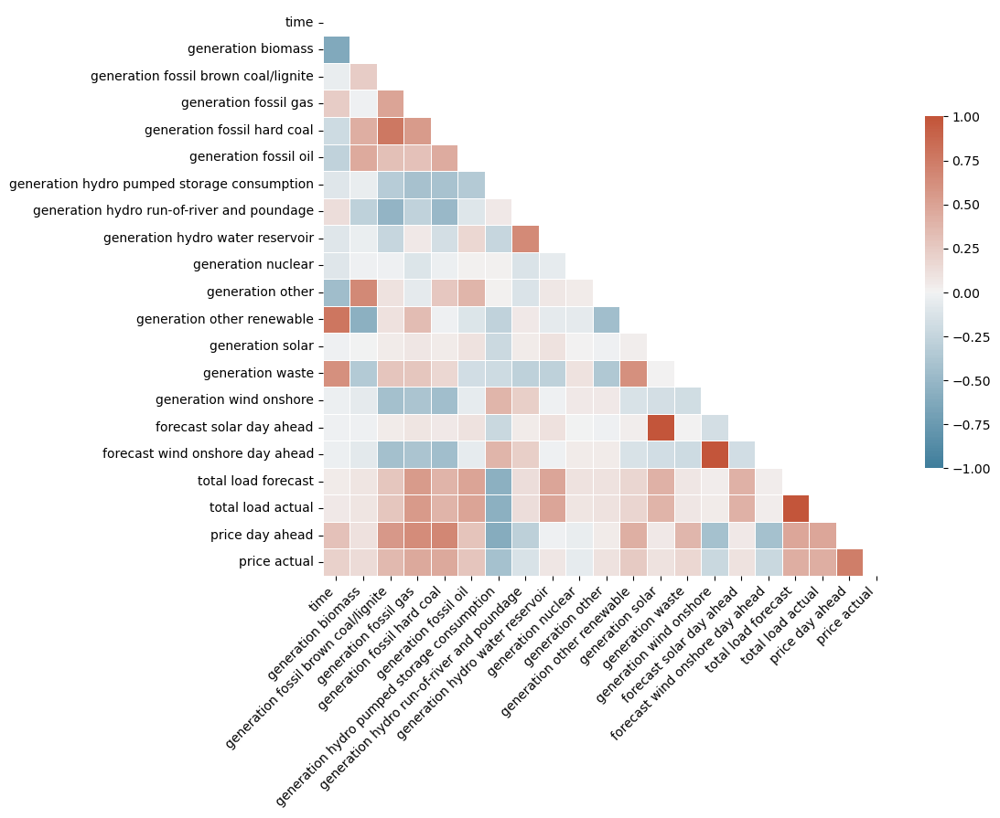

In [19]:
project_heatmap(df_energy)

### Pairs Plot

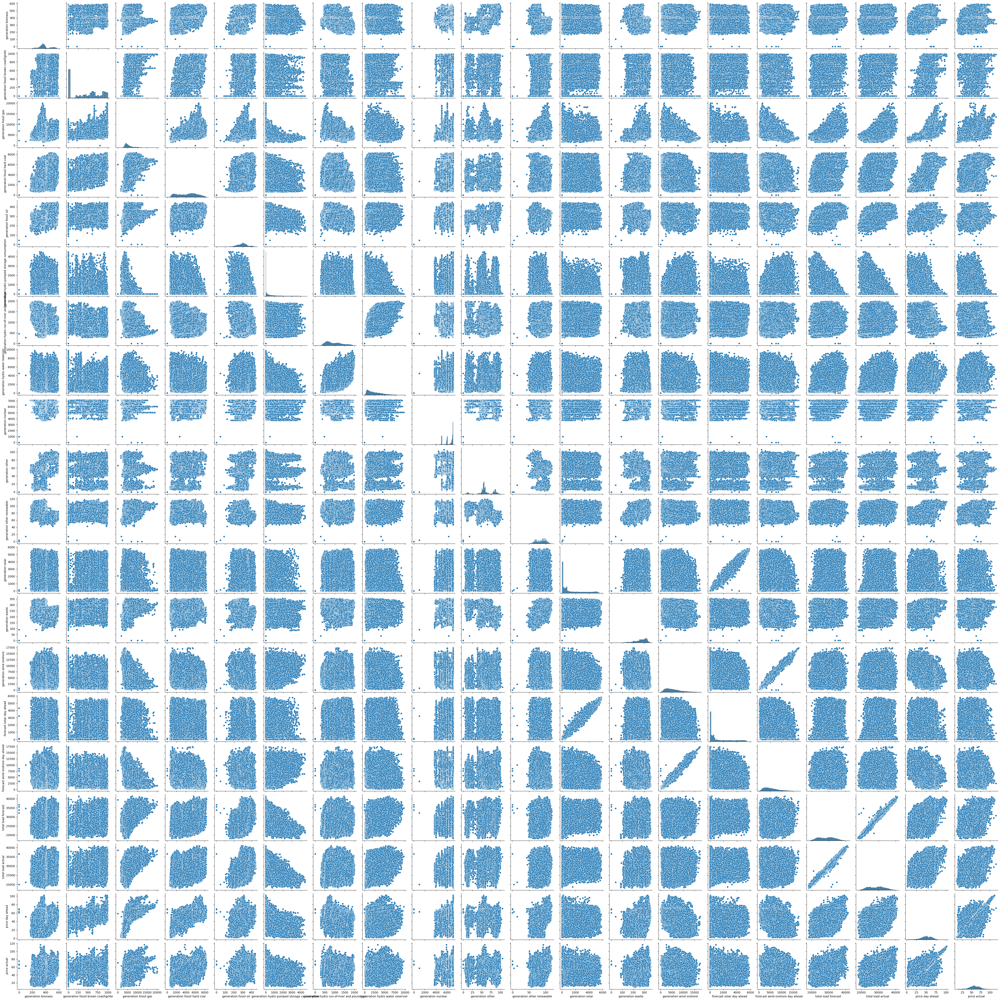

In [20]:
sns.pairplot(df_energy)

## Weather Visual Analysis

### Heatmap
* Simple encoding of the categorical data, to get a heat map of the raw data.

In [21]:
from sklearn.preprocessing import LabelEncoder
weather_cols_to_encode = ['city_name', 'weather_main', 'weather_description', 'weather_icon']
label_enc = LabelEncoder()
for col in weather_cols_to_encode:
    df_weather[col+'_encoded'] = label_enc.fit_transform(df_weather[col])
df_weather_encoded = df_weather.drop(columns=weather_cols_to_encode)

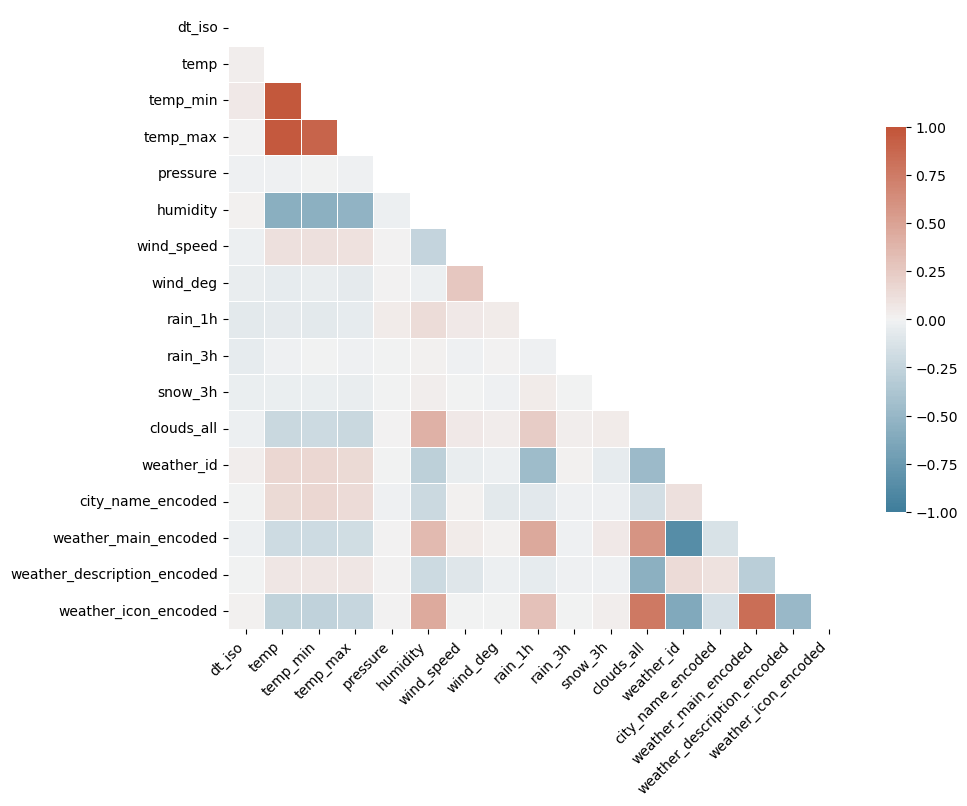

In [22]:
project_heatmap(df_weather_encoded)

### Pairs Plot

In [23]:
# sns.pairplot(df_weather_encoded)
# Do not run this unless you have a super computer...

### Creating an average dataset of the weather data for the numerical data and dropping the categorical data.
* This is important so the size of the data frames match when we use linear regression models.

In [24]:
df_weather_avg = df_weather.drop(['city_name', 'weather_id', 'weather_main', 'weather_description', 'weather_icon', 'city_name_encoded', 'weather_main_encoded', 'weather_description_encoded', 'weather_icon_encoded'], axis = 1)
df_weather_avg = df_weather_avg.groupby(['dt_iso']).mean().reset_index()
df_weather_avg

,dt_iso,temp,temp_min,temp_max,pressure,humidity,wind_speed,wind_deg,rain_1h,rain_3h,snow_3h,clouds_all
0,2014-12-31 23:00:00,272.491463,272.491463,272.491463,1016.4,82.4,2.0,135.2,0.0,0.0,0.0,0.0
1,2015-01-01 00:00:00,272.512700,272.512700,272.512700,1016.2,82.4,2.0,135.8,0.0,0.0,0.0,0.0
2,2015-01-01 01:00:00,272.099137,272.099137,272.099137,1016.8,82.0,2.4,119.0,0.0,0.0,0.0,0.0
3,2015-01-01 02:00:00,272.089469,272.089469,272.089469,1016.6,82.0,2.4,119.2,0.0,0.0,0.0,0.0
4,2015-01-01 03:00:00,272.145900,272.145900,272.145900,1016.6,82.0,2.4,118.4,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...
35059,2018-12-31 18:00:00,284.470000,283.350000,285.550000,1029.2,73.6,1.4,151.4,0.0,0.0,0.0,0.0
35060,2018-12-31 19:00:00,282.294000,280.950000,283.350000,1030.0,68.0,1.8,160.4,0.0,0.0,0.0,0.0
35061,2018-12-31 20:00:00,280.850000,280.350000,281.350000,1029.8,71.4,2.6,226.0,0.0,0.0,0.0,0.0
35062,2018-12-31 21:00:00,279.718000,278.750000,280.750000,1030.2,70.0,2.8,230.0,0.0,0.0,0.0,0.0


### Averaged Weather Dataframe Pair Plot

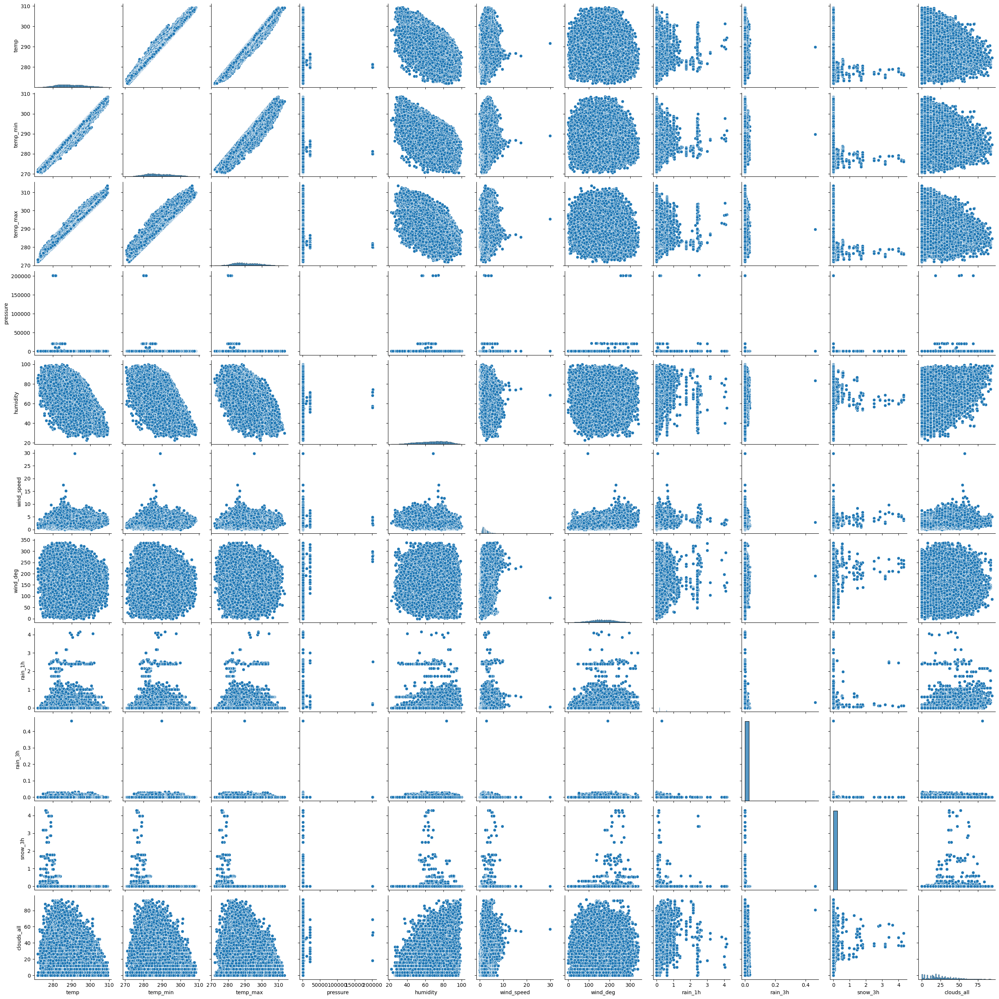

In [25]:
sns.pairplot(df_weather_avg)

### Add columns to df_weather_avg and df_energy that include encoded times. For example, day, month, year, day of week, day of month, day of year.

In [26]:
df_weather_avg['dt_iso'] = pd.to_datetime(df_weather_avg['dt_iso'])

df_weather_avg['year'] = df_weather_avg['dt_iso'].dt.year
df_weather_avg['month'] = df_weather_avg['dt_iso'].dt.month
df_weather_avg['dayofmonth'] = df_weather_avg['dt_iso'].dt.day
df_weather_avg['hour'] = df_weather_avg['dt_iso'].dt.hour
df_weather_avg['dayofweek'] = df_weather_avg['dt_iso'].dt.dayofweek
df_weather_avg['dayofyear'] = df_weather_avg['dt_iso'].dt.dayofyear

In [27]:
df_weather_avg = df_weather_avg.drop(['dt_iso'], axis = 1)

In [28]:
df_energy['time'] = pd.to_datetime(df_energy['time'])
df_energy['year'] = df_energy['time'].dt.year
df_energy['month'] = df_energy['time'].dt.month
df_energy['dayofmonth'] = df_energy['time'].dt.day
df_energy['hour'] = df_energy['time'].dt.hour
df_energy['dayofweek'] = df_energy['time'].dt.dayofweek
df_energy['dayofyear'] = df_energy['time'].dt.dayofyear

In [29]:
df_energy = df_energy.drop(['time'], axis = 1)

### Addressing the null values that exist in the df_energy dataset.

In [30]:
rows_with_null = df_energy[df_energy.isnull().any(axis=1)]
rows_with_null

,generation biomass,generation fossil brown coal/lignite,generation fossil gas,generation fossil hard coal,generation fossil oil,generation hydro pumped storage consumption,generation hydro run-of-river and poundage,generation hydro water reservoir,generation nuclear,generation other,...,total load forecast,total load actual,price day ahead,price actual,year,month,dayofmonth,hour,dayofweek,dayofyear
99,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,21912.0,21182.0,35.20,59.68,2015,1,5,2,0,5
108,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,23209.0,NaN,35.50,79.14,2015,1,5,11,0,5
109,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,23725.0,NaN,36.80,73.95,2015,1,5,12,0,5
110,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,23614.0,NaN,32.50,71.93,2015,1,5,13,0,5
111,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,22381.0,NaN,30.00,71.50,2015,1,5,14,0,5
112,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,21371.0,NaN,30.00,71.85,2015,1,5,15,0,5
113,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,20760.0,NaN,30.60,80.53,2015,1,5,16,0,5
451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,38642.0,39304.0,70.01,88.95,2015,1,19,18,0,19
452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,38758.0,39262.0,69.00,87.94,2015,1,19,19,0,19
643,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,38968.0,38335.0,66.00,83.97,2015,1,27,18,1,27


#### Create a dataframe where the mean of the entire column is placed into the null variables.

In [31]:
df_energy_NaN_mean = df_energy.fillna(df_energy.mean())

#### Create a dataframe where the k-nearest neighbors average of each null variable is substituted for the null.

In [32]:
from sklearn.impute import KNNImputer

imputer = KNNImputer(n_neighbors=14)
df_energy_NaN_KNN = pd.DataFrame(imputer.fit_transform(df_energy), columns=df_energy.columns)

#### Generalizing function for simple linear regression model:

In [33]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
import matplotlib.pyplot as plt


def simple_linear_reg_model(df_feat, df_targ, train_pct, test_pct):
    X = df_feat
    y = df_targ
    
    train_r = train_pct
    test_r = test_pct
    
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_r, random_state=584)
    
    print(f'Features Training Data Shape: {X_train.shape}')
    print(f'Features Testing  Data Shape: {X_test.shape}')
    print(f'Target Training   Data Shape: {y_train.shape}')
    print(f'Target Testing    Data Shape: {y_test.shape}')

    model = LinearRegression()
    model.fit(X_train, y_train)

    y_pred = model.predict(X_test)
    mse = mean_squared_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)
    print(f'Mean Squared Error: {mse}')
    print(f'R-squared: {r2}')

#### Comparing the performance of the null data with mean adn null data with knn.
* The performance of the two is very comperable. You would expect, that using the mean value for the entire column would perform better with linear regression. The KNN imputation slightly worse, but the nearest neighbors average is likely a better estimate and representation the values.

In [34]:
simple_linear_reg_model(df_weather_avg, 
                        df_energy_NaN_mean[["generation solar"]], 0.60, 0.40)

Features Training Data Shape: (21038, 17)
Features Testing  Data Shape: (14026, 17)
Target Training   Data Shape: (21038, 1)
Target Testing    Data Shape: (14026, 1)
Mean Squared Error: 1713396.7039807336
R-squared: 0.3972204175163849


In [35]:
simple_linear_reg_model(df_weather_avg, 
                        df_energy_NaN_KNN[["generation solar"]], 0.60, 0.40)

Features Training Data Shape: (21038, 17)
Features Testing  Data Shape: (14026, 17)
Target Training   Data Shape: (21038, 1)
Target Testing    Data Shape: (14026, 1)
Mean Squared Error: 1716649.5461755225
R-squared: 0.3966134149495354


In [36]:
simple_linear_reg_model(df_weather_avg, 
                        df_energy_NaN_mean[["generation solar"]], 0.80, 0.20)

Features Training Data Shape: (28051, 17)
Features Testing  Data Shape: (7013, 17)
Target Training   Data Shape: (28051, 1)
Target Testing    Data Shape: (7013, 1)
Mean Squared Error: 1715150.4964800114
R-squared: 0.3852376479747631


In [37]:
simple_linear_reg_model(df_weather_avg, 
                        df_energy_NaN_KNN[["generation solar"]], 0.80, 0.20)

Features Training Data Shape: (28051, 17)
Features Testing  Data Shape: (7013, 17)
Target Training   Data Shape: (28051, 1)
Target Testing    Data Shape: (7013, 1)
Mean Squared Error: 1720718.8448106472
R-squared: 0.3841899641073654


#### While we do have a positive correlation for the weather and solar generation, its value is only 0.37 to 0.40. If we remove weaker features from the calculation maybe we can improve upon this model and correlation.
* Use the RandomForestRegressor to extract the strongest features and re-perform the linear regression.

In [38]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.datasets import make_classification

def Rand_Forest_Reg(df_feat, df_targ):
    X = df_feat
    y = df_targ
    
    RFC = RandomForestRegressor()
    RFC.fit(X, y)
    feature_importances = RFC.feature_importances_
    indices = np.argsort(feature_importances)[::-1]
    
    print("Feature ranking:")
    for f in range(X.shape[1]):
        print(f"{X.columns[indices[f]]}: {feature_importances[indices[f]]}")

In [39]:
Rand_Forest_Reg(df_weather_avg, 
                df_energy_NaN_KNN["generation solar"])

Feature ranking:
hour: 0.4514619154986584
humidity: 0.3102248065185273
dayofmonth: 0.09487749880372653
dayofyear: 0.03301092778831356
temp_min: 0.018013765754381104
clouds_all: 0.01471354774986417
temp: 0.014258609128677095
pressure: 0.01281678123647475
temp_max: 0.010313888584700075
year: 0.00944031639844742
wind_deg: 0.008767198394241033
wind_speed: 0.00735872319245217
dayofweek: 0.006582066395075351
month: 0.00412398213296499
rain_1h: 0.0029901102453097073
rain_3h: 0.0010194784685137286
snow_3h: 2.6383709672554695e-05


In [40]:
simple_linear_reg_model(df_weather_avg[["hour", "humidity", "dayofmonth", "dayofyear", "temp_min", "clouds_all", "temp", "pressure", "temp_max"]], 
                        df_energy_NaN_mean[["generation solar"]], 0.60, 0.40)

Features Training Data Shape: (21038, 9)
Features Testing  Data Shape: (14026, 9)
Target Training   Data Shape: (21038, 1)
Target Testing    Data Shape: (14026, 1)
Mean Squared Error: 1745562.2075463939
R-squared: 0.38590446904710285


#### No real improvement selecting for the strongest features. Another thing we can try, because the weather dataframe is average cross all five cities, are cities that are closer to larger collection of solar panels.
* Making data frames for the individual cities.
  

In [41]:
df_weather_with_cities = df_weather.drop(['weather_id', 'weather_main', 'weather_description', 'weather_icon', 'city_name_encoded', 'weather_main_encoded', 'weather_description_encoded', 'weather_icon_encoded'], axis = 1)

In [42]:
from sklearn.preprocessing import LabelEncoder

weather_cols_to_encode = ['city_name']
label_enc = LabelEncoder()
for col in weather_cols_to_encode:
    df_weather_with_cities[col+'_encoded'] = label_enc.fit_transform(df_weather_with_cities[col])
df_weather_with_cities_encoded = df_weather_with_cities.drop(columns=weather_cols_to_encode)

In [43]:
df_weather_with_city_0_encoded = df_weather_with_cities_encoded[df_weather_with_cities_encoded['city_name_encoded'] == 0]
df_weather_with_city_1_encoded = df_weather_with_cities_encoded[df_weather_with_cities_encoded['city_name_encoded'] == 1]
df_weather_with_city_2_encoded = df_weather_with_cities_encoded[df_weather_with_cities_encoded['city_name_encoded'] == 2]
df_weather_with_city_3_encoded = df_weather_with_cities_encoded[df_weather_with_cities_encoded['city_name_encoded'] == 3]
df_weather_with_city_4_encoded = df_weather_with_cities_encoded[df_weather_with_cities_encoded['city_name_encoded'] == 4]

In [44]:
df_weather_with_city_0_encoded = df_weather_with_city_0_encoded.groupby(['dt_iso']).mean().reset_index()
df_weather_with_city_1_encoded = df_weather_with_city_1_encoded.groupby(['dt_iso']).mean().reset_index()
df_weather_with_city_2_encoded = df_weather_with_city_2_encoded.groupby(['dt_iso']).mean().reset_index()
df_weather_with_city_3_encoded = df_weather_with_city_3_encoded.groupby(['dt_iso']).mean().reset_index()
df_weather_with_city_4_encoded = df_weather_with_city_4_encoded.groupby(['dt_iso']).mean().reset_index()

In [45]:
def add_daymoyr(df):
    dta = df.copy()
    dta['dt_iso'] = pd.to_datetime(dta['dt_iso'])
    dta['year'] = dta['dt_iso'].dt.year
    dta['month'] = dta['dt_iso'].dt.month
    dta['dayofmonth'] = df_weather_with_cities['dt_iso'].dt.day
    dta['hour'] = dta['dt_iso'].dt.hour
    dta['dayofweek'] = dta['dt_iso'].dt.dayofweek
    dta['dayofyear'] = dta['dt_iso'].dt.dayofyear

    return dta

In [46]:
df_weather_with_city_0_encoded = add_daymoyr(df_weather_with_city_0_encoded)
df_weather_with_city_1_encoded = add_daymoyr(df_weather_with_city_1_encoded)
df_weather_with_city_2_encoded = add_daymoyr(df_weather_with_city_2_encoded)
df_weather_with_city_3_encoded = add_daymoyr(df_weather_with_city_3_encoded)
df_weather_with_city_4_encoded = add_daymoyr(df_weather_with_city_4_encoded)

In [47]:
df_weather_with_city_0_encoded = df_weather_with_city_0_encoded.drop(['dt_iso'], axis = 1)
df_weather_with_city_1_encoded = df_weather_with_city_1_encoded.drop(['dt_iso'], axis = 1)
df_weather_with_city_2_encoded = df_weather_with_city_2_encoded.drop(['dt_iso'], axis = 1)
df_weather_with_city_3_encoded = df_weather_with_city_3_encoded.drop(['dt_iso'], axis = 1)
df_weather_with_city_4_encoded = df_weather_with_city_4_encoded.drop(['dt_iso'], axis = 1)

In [48]:
df_weather_with_city_4_encoded.head()

,temp,temp_min,temp_max,pressure,humidity,wind_speed,wind_deg,rain_1h,rain_3h,snow_3h,clouds_all,city_name_encoded,year,month,dayofmonth,hour,dayofweek,dayofyear
0,270.475,270.475,270.475,1001.0,77.0,1.0,62.0,0.0,0.0,0.0,0.0,4.0,2014,12,31,23,2,365
1,270.475,270.475,270.475,1001.0,77.0,1.0,62.0,0.0,0.0,0.0,0.0,4.0,2015,1,1,0,3,1
2,269.686,269.686,269.686,1002.0,78.0,0.0,23.0,0.0,0.0,0.0,0.0,4.0,2015,1,1,1,3,1
3,269.686,269.686,269.686,1002.0,78.0,0.0,23.0,0.0,0.0,0.0,0.0,4.0,2015,1,1,2,3,1
4,269.686,269.686,269.686,1002.0,78.0,0.0,23.0,0.0,0.0,0.0,0.0,4.0,2015,1,1,3,3,1


### With dataframes for each city's weather, now run recompute random forest regression and linear regression for each city.

In [49]:
Rand_Forest_Reg(df_weather_with_city_0_encoded, 
                df_energy_NaN_KNN["generation solar"])

Feature ranking:
hour: 0.6891206094390605
dayofmonth: 0.08284370521236499
temp_max: 0.052370798274820635
dayofyear: 0.052364821581000726
pressure: 0.01824847016741065
humidity: 0.017344428145500728
year: 0.01596337284253614
dayofweek: 0.011940930901044927
wind_deg: 0.011397093546769876
month: 0.011304481551160045
temp: 0.011207836781831826
temp_min: 0.00882748215684169
clouds_all: 0.008052709146286963
wind_speed: 0.006827818178976311
rain_1h: 0.0014572488915751505
rain_3h: 0.0007281931828188532
snow_3h: 0.0
city_name_encoded: 0.0


In [50]:
Rand_Forest_Reg(df_weather_with_city_1_encoded, 
                df_energy_NaN_KNN["generation solar"])

Feature ranking:
hour: 0.6923938756335961
dayofyear: 0.08134090534952344
dayofmonth: 0.078412848464039
pressure: 0.02793241098467707
temp: 0.024968795352459456
year: 0.017145601788112388
temp_min: 0.01540207229405512
month: 0.011172303200167667
dayofweek: 0.011102060194382197
wind_deg: 0.009931661972358447
humidity: 0.009774611018147753
temp_max: 0.007549052726464914
clouds_all: 0.006186196574142941
wind_speed: 0.004815610871293468
rain_1h: 0.0012526978055954238
rain_3h: 0.000586888646596836
snow_3h: 3.240712438771301e-05
city_name_encoded: 0.0


In [51]:
Rand_Forest_Reg(df_weather_with_city_2_encoded, 
                df_energy_NaN_KNN["generation solar"])

Feature ranking:
hour: 0.6879961626167264
dayofmonth: 0.08464118726264781
humidity: 0.07116306112360973
dayofyear: 0.03544359294715178
temp_min: 0.01715089108457573
temp_max: 0.015646147756715318
year: 0.015489247497519955
pressure: 0.01519380246586321
temp: 0.012450651994922705
wind_deg: 0.010507306866538797
dayofweek: 0.009744040012644582
clouds_all: 0.00914659568296352
month: 0.007947019856154303
wind_speed: 0.006373920235742188
rain_1h: 0.0009602031015206343
rain_3h: 0.00014612724953202869
snow_3h: 4.22451713799227e-08
city_name_encoded: 0.0


In [52]:
Rand_Forest_Reg(df_weather_with_city_3_encoded, 
                df_energy_NaN_KNN["generation solar"])

Feature ranking:
hour: 0.6884731800682256
dayofmonth: 0.08403228982561636
temp_min: 0.04150366672846999
dayofyear: 0.04071376928134591
humidity: 0.03302582061401402
temp: 0.025086115149047093
year: 0.015945841449267337
pressure: 0.013897605361195905
wind_deg: 0.011115209189234134
clouds_all: 0.009969677275044081
month: 0.009649145503868792
dayofweek: 0.009259633684098318
temp_max: 0.008404345422861448
wind_speed: 0.007752387330218694
rain_1h: 0.000962632453207522
rain_3h: 0.00020868066428494193
city_name_encoded: 0.0
snow_3h: 0.0


In [53]:
Rand_Forest_Reg(df_weather_with_city_4_encoded, 
                df_energy_NaN_KNN["generation solar"])

Feature ranking:
hour: 0.6654478323596713
dayofmonth: 0.08170381426925825
humidity: 0.04581941617807852
temp_max: 0.0452132225079648
dayofyear: 0.044320937085311846
temp: 0.020880011773675013
pressure: 0.0197092328833721
year: 0.01690678145631638
temp_min: 0.012105504485463082
dayofweek: 0.01182279862512226
wind_deg: 0.011179970111665183
month: 0.009758695026521684
wind_speed: 0.007100975550733864
clouds_all: 0.006951931805967319
rain_1h: 0.0006206047014381515
rain_3h: 0.00045766377065623005
snow_3h: 6.07408783970823e-07
city_name_encoded: 0.0


### The strength of the hour feature is proving to be much stronger, for individual cities, which makes sense, because the sun would be out the same times of the day for a given location.

In [54]:
simple_linear_reg_model(df_weather_with_city_0_encoded[["hour", "dayofyear", "dayofmonth", "temp_max", "pressure", 'humidity', 'temp', 'clouds_all', 'month', 'wind_deg', 'dayofweek', 'temp_min']],
                        df_energy_NaN_KNN[["generation solar"]], 0.80, 0.20)

Features Training Data Shape: (28051, 12)
Features Testing  Data Shape: (7013, 12)
Target Training   Data Shape: (28051, 1)
Target Testing    Data Shape: (7013, 1)
Mean Squared Error: 2042579.6986873979
R-squared: 0.26900255590525035


In [55]:
simple_linear_reg_model(df_weather_with_city_1_encoded[["hour", "dayofyear", "dayofmonth", "temp_max", "pressure", 'humidity', 'temp', 'clouds_all', 'month', 'wind_deg', 'dayofweek', 'temp_min']],
                        df_energy_NaN_KNN[["generation solar"]], 0.80, 0.20)

Features Training Data Shape: (28051, 12)
Features Testing  Data Shape: (7013, 12)
Target Training   Data Shape: (28051, 1)
Target Testing    Data Shape: (7013, 1)
Mean Squared Error: 2107699.498845751
R-squared: 0.24569751301938048


In [56]:
simple_linear_reg_model(df_weather_with_city_2_encoded[["hour", "dayofyear", "dayofmonth", "temp_max", "pressure", 'humidity', 'temp', 'clouds_all', 'month', 'wind_deg', 'dayofweek', 'temp_min']],
                        df_energy_NaN_KNN[["generation solar"]], 0.80, 0.20)

Features Training Data Shape: (28051, 12)
Features Testing  Data Shape: (7013, 12)
Target Training   Data Shape: (28051, 1)
Target Testing    Data Shape: (7013, 1)
Mean Squared Error: 2241094.914069933
R-squared: 0.19795802572030574


In [57]:
simple_linear_reg_model(df_weather_with_city_3_encoded[["hour", "dayofyear", "dayofmonth", "temp_max", "pressure", 'humidity', 'temp', 'clouds_all', 'month', 'wind_deg', 'dayofweek', 'temp_min']],
                        df_energy_NaN_KNN[["generation solar"]], 0.80, 0.20)

Features Training Data Shape: (28051, 12)
Features Testing  Data Shape: (7013, 12)
Target Training   Data Shape: (28051, 1)
Target Testing    Data Shape: (7013, 1)
Mean Squared Error: 2015117.5751474125
R-squared: 0.27883068752236373


In [58]:
simple_linear_reg_model(df_weather_with_city_4_encoded[["hour", "dayofyear", "dayofmonth", "temp_max", "pressure", 'humidity', 'temp', 'clouds_all', 'month', 'wind_deg', 'dayofweek', 'temp_min']],
                        df_energy_NaN_KNN[["generation solar"]], 0.80, 0.20)

Features Training Data Shape: (28051, 12)
Features Testing  Data Shape: (7013, 12)
Target Training   Data Shape: (28051, 1)
Target Testing    Data Shape: (7013, 1)
Mean Squared Error: 1818513.346647452
R-squared: 0.3491913146372062


### This does demonstrate that certain cities are closer to or are home to more solar panels. City 4 has the substantially higher correlection compared to all other cities. But linear regression does not appear to be a strong model for prediction. Attempting some new models.

In [59]:
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score

def lr_kfold_model(df_feat, df_targ, splits=10, rand_st=584):
    X = df_feat
    y = df_targ
    
    kf = KFold(n_splits=splits, shuffle=True, random_state=rand_st)
    
    lr_model = LinearRegression()
    
    scores = cross_val_score(lr_model, X, y, cv=kf, scoring='neg_mean_squared_error')
    print(f'Cross-validated scores: {scores}')
    print(f'Average RMSE: {np.sqrt(-scores.mean())}')

In [60]:
from sklearn.neighbors import KNeighborsRegressor

def kn_reg_model(df_feat, df_targ, neighb=5, train_pct=0.80, test_pct=0.20):
    X = df_feat
    y = df_targ
    
    train_r = train_pct
    test_r = test_pct
    
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_r)

    print(f'Features Training Data Shape: {X_train.shape}')
    print(f'Features Testing  Data Shape: {X_test.shape}')
    print(f'Target Training   Data Shape: {y_train.shape}')
    print(f'Target Testing    Data Shape: {y_test.shape}')
    
    KNN_model = KNeighborsRegressor(n_neighbors=neighb)
    KNN_model.fit(X_train, y_train)
    y_pred = KNN_model.predict(X_test)
    mse = mean_squared_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)
    print(f'Mean Squared Error: {mse}')
    print(f'R^2 Score: {r2}')

In [61]:
lr_kfold_model(df_weather_avg, 
               df_energy_NaN_KNN[["generation solar"]], splits=5)

Cross-validated scores: [-1720718.84481065 -1713377.47369582 -1700043.43914194 -1704471.03011225
 -1731515.92716891]
Average RMSE: 1309.2079067076832


In [62]:
lr_kfold_model(df_weather_avg, 
               df_energy_NaN_KNN[["generation solar"]], splits=10)

Cross-validated scores: [-1698827.73098193 -1741274.73502925 -1684043.93417756 -1742120.2541643
 -1697214.47477249 -1702095.37536694 -1727111.82032865 -1681797.38875257
 -1704494.88298204 -1759493.01833378]
Average RMSE: 1309.139931974024


In [63]:
kn_reg_model(df_weather_avg, 
             df_energy_NaN_KNN[["generation solar"]], neighb=5, train_pct=0.8, test_pct=0.2)

Features Training Data Shape: (28051, 17)
Features Testing  Data Shape: (7013, 17)
Target Training   Data Shape: (28051, 1)
Target Testing    Data Shape: (7013, 1)
Mean Squared Error: 1127454.3520070598
R^2 Score: 0.5985488983271653


In [64]:
kn_reg_model(df_weather_avg, 
             df_energy_NaN_KNN[["generation solar"]], neighb=10, train_pct=0.8, test_pct=0.2)

Features Training Data Shape: (28051, 17)
Features Testing  Data Shape: (7013, 17)
Target Training   Data Shape: (28051, 1)
Target Testing    Data Shape: (7013, 1)
Mean Squared Error: 1183704.3175766214
R^2 Score: 0.5750277365184902


### Weather - Generation Wind Onshore

In [65]:
simple_linear_reg_model(df_weather_avg, 
                        df_energy_NaN_KNN[["generation wind onshore"]], 0.80, 0.20)

Features Training Data Shape: (28051, 17)
Features Testing  Data Shape: (7013, 17)
Target Training   Data Shape: (28051, 1)
Target Testing    Data Shape: (7013, 1)
Mean Squared Error: 8662455.337195864
R-squared: 0.15676949033170096


In [66]:
simple_linear_reg_model(df_weather_avg[['temp', 'temp_min', 'temp_max',	'pressure',	'humidity',	'wind_speed', 'rain_1h', 'rain_3h',	'snow_3h', 'clouds_all', 'year', 'month', 'dayofmonth', 'hour', 'dayofweek', 'dayofyear']], 
                        df_energy_NaN_KNN[["generation wind onshore"]], 0.80, 0.20)

Features Training Data Shape: (28051, 16)
Features Testing  Data Shape: (7013, 16)
Target Training   Data Shape: (28051, 1)
Target Testing    Data Shape: (7013, 1)
Mean Squared Error: 8714588.719764309
R-squared: 0.15169466373315443


In [67]:
lr_kfold_model(df_weather_avg,
               df_energy_NaN_KNN[["generation wind onshore"]], splits=5)

Cross-validated scores: [-8662455.33719587 -8749408.08713585 -8818171.23785589 -8732451.69616612
 -8614654.02178218]
Average RMSE: 2952.1903861416495


In [68]:
lr_kfold_model(df_weather_avg[['temp', 'temp_min', 'temp_max', 'pressure', 'humidity', 'wind_speed', 'rain_1h', 'rain_3h', 'snow_3h', 'clouds_all', 'year', 'month', 'dayofmonth', 'hour', 'dayofweek', 'dayofyear']],
               df_energy_NaN_KNN[["generation wind onshore"]], splits=5)

Cross-validated scores: [-8714588.71976431 -8765855.72226482 -8866503.52193056 -8752376.18637033
 -8641449.95441514]
Average RMSE: 2957.727982920172


In [69]:
kn_reg_model(df_weather_avg, 
             df_energy_NaN_KNN[["generation wind onshore"]], neighb=5, train_pct=0.8, test_pct=0.2)

Features Training Data Shape: (28051, 17)
Features Testing  Data Shape: (7013, 17)
Target Training   Data Shape: (28051, 1)
Target Testing    Data Shape: (7013, 1)
Mean Squared Error: 6448592.98346351
R^2 Score: 0.3753512248361335


In [70]:
kn_reg_model(df_weather_avg[['temp', 'temp_min', 'temp_max', 'pressure', 'humidity', 'wind_speed', 'rain_1h', 'rain_3h', 'snow_3h', 'clouds_all', 'year', 'month', 'dayofmonth', 'hour', 'dayofweek', 'dayofyear']], 
             df_energy_NaN_KNN[["generation wind onshore"]], neighb=5, train_pct=0.8, test_pct=0.2)

Features Training Data Shape: (28051, 16)
Features Testing  Data Shape: (7013, 16)
Target Training   Data Shape: (28051, 1)
Target Testing    Data Shape: (7013, 1)
Mean Squared Error: 4058421.41785189
R^2 Score: 0.6040741062501618


In [71]:
kn_reg_model(df_weather_avg, 
             df_energy_NaN_KNN[["generation wind onshore"]], neighb=10, train_pct=0.8, test_pct=0.2)

Features Training Data Shape: (28051, 17)
Features Testing  Data Shape: (7013, 17)
Target Training   Data Shape: (28051, 1)
Target Testing    Data Shape: (7013, 1)
Mean Squared Error: 6789655.55596647
R^2 Score: 0.3374078659720663


In [72]:
kn_reg_model(df_weather_avg[['temp', 'temp_min', 'temp_max', 'pressure', 'humidity', 'wind_speed', 'rain_1h', 'rain_3h', 'snow_3h', 'clouds_all', 'year', 'month', 'dayofmonth', 'hour', 'dayofweek', 'dayofyear']], 
             df_energy_NaN_KNN[["generation wind onshore"]], neighb=10, train_pct=0.8, test_pct=0.2)

Features Training Data Shape: (28051, 16)
Features Testing  Data Shape: (7013, 16)
Target Training   Data Shape: (28051, 1)
Target Testing    Data Shape: (7013, 1)
Mean Squared Error: 4799762.540071747
R^2 Score: 0.5353277387091755


### Weather - Energy Price

In [73]:
simple_linear_reg_model(df_weather_avg,
                        df_energy_NaN_KNN[["price actual"]], 0.80, 0.20)

Features Training Data Shape: (28051, 17)
Features Testing  Data Shape: (7013, 17)
Target Training   Data Shape: (28051, 1)
Target Testing    Data Shape: (7013, 1)
Mean Squared Error: 148.63573091201812
R-squared: 0.25911631771930854


In [74]:
lr_kfold_model(df_weather_avg, 
               df_energy_NaN_KNN[["price actual"]], splits=5)

Cross-validated scores: [-148.63573091 -146.76959269 -151.4763821  -151.69637776 -152.21512115]
Average RMSE: 12.253923491023938


In [75]:
kn_reg_model(df_weather_avg, 
             df_energy_NaN_KNN[["price actual"]], neighb=5, train_pct=0.8, test_pct=0.2)

Features Training Data Shape: (28051, 17)
Features Testing  Data Shape: (7013, 17)
Target Training   Data Shape: (28051, 1)
Target Testing    Data Shape: (7013, 1)
Mean Squared Error: 104.73488551832311
R^2 Score: 0.47872099165390625


### Energy Source and Energy Price

In [76]:
simple_linear_reg_model(df_energy_NaN_KNN.drop(["price actual", "price day ahead"], axis=1),
                        df_energy_NaN_KNN[["price actual"]], 0.80, 0.20)

Features Training Data Shape: (28051, 24)
Features Testing  Data Shape: (7013, 24)
Target Training   Data Shape: (28051, 1)
Target Testing    Data Shape: (7013, 1)
Mean Squared Error: 109.10354519379295
R-squared: 0.4561668596301207


In [77]:
lr_kfold_model(df_energy_NaN_KNN.drop(["price actual", "price day ahead"], axis=1),
               df_energy_NaN_KNN[["price actual"]], splits=5)

Cross-validated scores: [-109.10354519 -108.73170032 -113.24697468 -109.2890029  -109.40873725]
Average RMSE: 10.485990276091034


In [78]:
kn_reg_model(df_energy_NaN_KNN.drop(["price actual", "price day ahead"], axis=1),
             df_energy_NaN_KNN[["price actual"]], neighb=10, train_pct=0.8, test_pct=0.2)

Features Training Data Shape: (28051, 24)
Features Testing  Data Shape: (7013, 24)
Target Training   Data Shape: (28051, 1)
Target Testing    Data Shape: (7013, 1)
Mean Squared Error: 92.89413803621845
R^2 Score: 0.540245204573234


## Scaling the dataframes
* We have two separate data frames with different data types and columns, which complicates scaling across both at the same time.
* We can test if scaling them individually improves the accuracy of our prediction models.

In [79]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()

scaled_data_weather_avg = scaler.fit_transform(df_weather_avg)
df_s_weather_avg = pd.DataFrame(scaled_data_weather_avg, columns=df_weather_avg.columns)

scaled_data_energy_NaN_KNN = scaler.fit_transform(df_energy_NaN_KNN)
df_s_energy_NaN_KNN = pd.DataFrame(scaled_data_energy_NaN_KNN, columns=df_energy_NaN_KNN.columns)

### Scaled: Avg Weather - Generation Solar

In [80]:

simple_linear_reg_model(df_s_weather_avg, 
                        df_s_energy_NaN_KNN[["generation solar"]], 0.80, 0.20)

Features Training Data Shape: (28051, 17)
Features Testing  Data Shape: (7013, 17)
Target Training   Data Shape: (28051, 1)
Target Testing    Data Shape: (7013, 1)
Mean Squared Error: 0.6095995628764074
R-squared: 0.3841899641073653


In [81]:

kn_reg_model(df_s_weather_avg, 
             df_s_energy_NaN_KNN[["generation solar"]], neighb=5, train_pct=0.8, test_pct=0.2)

Features Training Data Shape: (28051, 17)
Features Testing  Data Shape: (7013, 17)
Target Training   Data Shape: (28051, 1)
Target Testing    Data Shape: (7013, 1)
Mean Squared Error: 0.21437543064635756
R^2 Score: 0.7850519741694195


### Scaled: Avg Weather - Generation Wind Onshore

In [82]:

simple_linear_reg_model(df_s_weather_avg, 
                        df_s_energy_NaN_KNN[["generation wind onshore"]], 0.80, 0.20)

Features Training Data Shape: (28051, 17)
Features Testing  Data Shape: (7013, 17)
Target Training   Data Shape: (28051, 1)
Target Testing    Data Shape: (7013, 1)
Mean Squared Error: 0.8388256248287731
R-squared: 0.1567694903317005


In [83]:

simple_linear_reg_model(df_s_weather_avg[['temp', 'temp_min', 'temp_max',	'pressure',	'humidity',	'wind_speed', 'rain_1h', 'rain_3h',	'snow_3h', 'clouds_all', 'year', 'month', 'dayofmonth', 'hour', 'dayofweek', 'dayofyear']], 
                        df_s_energy_NaN_KNN[["generation wind onshore"]], 0.80, 0.20)

Features Training Data Shape: (28051, 16)
Features Testing  Data Shape: (7013, 16)
Target Training   Data Shape: (28051, 1)
Target Testing    Data Shape: (7013, 1)
Mean Squared Error: 0.843873941443998
R-squared: 0.15169466373315443


In [84]:

kn_reg_model(df_s_weather_avg, 
             df_s_energy_NaN_KNN[["generation wind onshore"]], neighb=5, train_pct=0.8, test_pct=0.2)

Features Training Data Shape: (28051, 17)
Features Testing  Data Shape: (7013, 17)
Target Training   Data Shape: (28051, 1)
Target Testing    Data Shape: (7013, 1)
Mean Squared Error: 0.3371315839179939
R^2 Score: 0.660572256425863


In [85]:

kn_reg_model(df_s_weather_avg[['temp', 'temp_min', 'temp_max', 'pressure', 'humidity', 'wind_speed', 'rain_1h', 'rain_3h', 'snow_3h', 'clouds_all', 'year', 'month', 'dayofmonth', 'hour', 'dayofweek', 'dayofyear']], 
             df_s_energy_NaN_KNN[["generation wind onshore"]], neighb=5, train_pct=0.8, test_pct=0.2)

Features Training Data Shape: (28051, 16)
Features Testing  Data Shape: (7013, 16)
Target Training   Data Shape: (28051, 1)
Target Testing    Data Shape: (7013, 1)
Mean Squared Error: 0.2900378040386739
R^2 Score: 0.7096183166823968


### Scaled: Avg Weather - Energy Price

In [86]:

simple_linear_reg_model(df_s_weather_avg,
                        df_s_energy_NaN_KNN[["price actual"]], 0.80, 0.20)

Features Training Data Shape: (28051, 17)
Features Testing  Data Shape: (7013, 17)
Target Training   Data Shape: (28051, 1)
Target Testing    Data Shape: (7013, 1)
Mean Squared Error: 0.7367314138346874
R-squared: 0.25911631771930654


In [87]:

kn_reg_model(df_s_weather_avg, 
             df_s_energy_NaN_KNN[["price actual"]], neighb=5, train_pct=0.8, test_pct=0.2)

Features Training Data Shape: (28051, 17)
Features Testing  Data Shape: (7013, 17)
Target Training   Data Shape: (28051, 1)
Target Testing    Data Shape: (7013, 1)
Mean Squared Error: 0.2022347626585995
R^2 Score: 0.7974909720152933


### Energy (Sans Forecast) vs Energy Price

In [88]:

simple_linear_reg_model(df_s_energy_NaN_KNN.drop(["price actual", "price day ahead"], axis=1),
                        df_s_energy_NaN_KNN[["price actual"]], 0.80, 0.20)

Features Training Data Shape: (28051, 24)
Features Testing  Data Shape: (7013, 24)
Target Training   Data Shape: (28051, 1)
Target Testing    Data Shape: (7013, 1)
Mean Squared Error: 0.5407852379222253
R-squared: 0.4561668596301207


In [89]:

kn_reg_model(df_s_energy_NaN_KNN.drop(["price actual", "price day ahead"], axis=1),
             df_s_energy_NaN_KNN[["price actual"]], neighb=10, train_pct=0.8, test_pct=0.2)

Features Training Data Shape: (28051, 24)
Features Testing  Data Shape: (7013, 24)
Target Training   Data Shape: (28051, 1)
Target Testing    Data Shape: (7013, 1)
Mean Squared Error: 0.12659771216067842
R^2 Score: 0.8751407109690167


In [90]:
import numpy as np

from sklearn import metrics
from sklearn.cluster import DBSCAN

X = df_s_weather_avg

db = DBSCAN(eps=1, min_samples=7).fit(X)
labels = db.labels_

# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
n_noise_ = list(labels).count(-1)

print("Estimated number of clusters: %d" % n_clusters_)
print("Estimated number of noise points: %d" % n_noise_)

Estimated number of clusters: 571
Estimated number of noise points: 24532


/var/home/patric/.var/app/org.jupyter.JupyterLab/config/jupyterlab-desktop/jlab_server/lib/python3.8/site-packages/umap/umap_.py:1943: UserWarning: n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


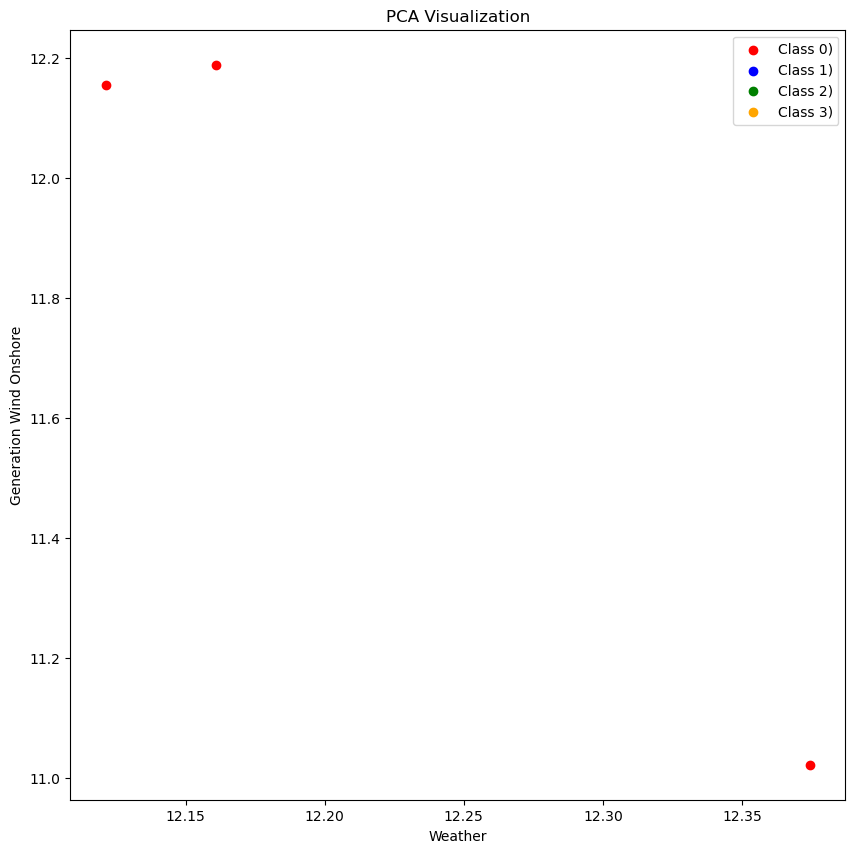

In [92]:
import umap.umap_ as umap
from sklearn.preprocessing import StandardScaler

def umap_model(df_feat, df_targ, n_comp=2):
    X = df_feat
    y = df_targ.values.ravel()

    scaler = StandardScaler()
    X_standardized = scaler.fit_transform(X)

    reducer = umap.UMAP(random_state=42)
    X_umap = reducer.fit_transform(X_standardized)

    plt.figure(figsize=(10,10))
    colors = ['red', 'blue', 'green', 'orange']

    for i in range(len(colors)):
        plt.scatter(X_umap[y == i, 0], X_umap[y == i, 1], c=colors[i], label=f'Class {i})')

    plt.title('PCA Visualization')
    plt.xlabel('Weather')
    plt.ylabel('Generation Wind Onshore')
    plt.legend()
    plt.show()

umap_model(df_weather_avg, df_energy_NaN_KNN[["generation wind onshore"]])